### To Do:

- preprocessing     (X)
- show each lens image with classification and probability     (X)
- look at test images or use the rest     (X)
- turn trained net on lens challenge sample     (X) 
- look at 22 and see the differences
- clean up, double check     (X)
- if still confident after checks, take 88 reshuffle and run again 
- give andrew lens set ask him to run it on XH pretrained ResNet (88/90)
- andrew get another 5000 images     (X)
- make jpeg catalog of all lenses (99) to sort them     (X)
### For future tests:

- 60/21/22 train/val/test split
    - scramble val after each model training
    - show AUC +/- for each
    - determine optimal number of epochs by comparing difference
    - preform 5 times
- Image Prep
    - cut off by symetric min (customized it)     (X)
    - match spread to CMU DeepLens     (X)
    - look at images before and after preprocessing     (X)

In [1]:
import sys
sys.path.append('..')
import time
from astropy.table import Table
import pyfits as fits
import numpy as np
import matplotlib.pyplot as plt
from os.path import expanduser
import random
from sklearn.utils import shuffle
import re
import shutil
home = expanduser("~")

In [2]:
def scramble_lens(lens, model_num):
    #load indices for lens images
    index = np.load('lens_file_indicies.npy')
    
    #empty array to fill with image data
    x_lens = np.zeros((lens,3,101,101))
    
    #target array for lens set
    y_lens = np.ones((lens,1))
    
    #number of images in each set category
    decalsA = 52
    decalsB = 22
    mzls = 7
    groupdecals = 30
    groupmzls = 12
    
    #convert chararray to array of int indicies
    num_index = np.array([])
    for i in index:
        num_index = np.concatenate((num_index,np.asarray((int(filter(str.isdigit, i)))).reshape(-1,)))
      
    #shuffle both sets of indicies
    index, none, num_index, none = train_test_split(index, num_index, test_size=1, shuffle = True)
    
    print index
    print num_index
    
    # loads lens images by cateory and assigns to array
    for i, (idx, num_idx) in enumerate(zip(index,num_index)):
        if idx[-1] == 'A':
#             print num_idx, idx
            x_lens[i] = fits.getdata('/Users/Chris/Desktop/DECals_set/Train/fits_images/lens_cutout_gradeA_{:06d}.fits'.format(int(num_idx)))
        elif idx[-1] == 'B':
#             print num_idx, idx
            x_lens[i] = fits.getdata('/Users/Chris/Desktop/DECals_set/Train/fits_images/lens_cutout_gradeB_{:06d}.fits'.format(int(num_idx)))
        elif idx[-1] == 'S':
#             print num_idx, idx
            x_lens[i] = fits.getdata('/Users/Chris/Desktop/DECals_set/Train/fits_images/lens_cutout_MzLS_{:06d}.fits'.format(int(num_idx)))
        elif 'DECals_group' in idx:
#             print num_idx, idx
            x_lens[i] = fits.getdata('/Users/Chris/Desktop/DECals_set/Train/fits_images/lens_cutout_group_DECals_{:06d}.fits'.format(int(num_idx)))
        elif 'MzLS_group' in idx:
#             print num_idx, idx
            x_lens[i] = fits.getdata('/Users/Chris/Desktop/DECals_set/Train/fits_images/lens_cutout_group_MzLS_{:06d}.fits'.format(int(num_idx)))
    
    #save shuffled array
    np.save('/Users/Chris/Desktop/DECals_set/Trained_Models/model_{}/x_y_sets/shuffled_index_lens.npy'.format(model_num), index)
    print 'shuffled indices saved.'
    
    #clip train/val to 88/35
    x_train = x_lens[:88]
    xval = x_lens[88:]
    y_train = y_lens[:88]
    yval = y_lens[88:]
    
    print 'x_lens_train shape:',x_train.shape
    print 'y_lens_train shape: ', y_train.shape
    print 'confirm number of lenses (train): ', np.sum(y_train)
    print 'x_lens_val shape:',xval.shape
    print 'y_lens_val shape:',yval.shape
    print 'confirm number of lenses(val): ', np.sum(yval)
    
    
    return x_train, xval, y_train, yval

In [3]:
def scramble_nonlens(nonlens, model_num):
    #load indicies of non-lens images 
    index = np.load('selected_train_images.npy')
    
    #empty array to fill with image data
    x_nonlens = np.zeros((nonlens,3,101,101))
    
    #target array for non-lens set
    y_nonlens = np.zeros((nonlens,1))
    print index[:10]
    
    #shuffle set of indicies
    index, none, none, none = train_test_split(index,np.zeros((index.shape[0])), test_size=1, shuffle = True)
    
    print index[:10]
    
    #load image data and assign to array
    for i, idx in enumerate(index):
        x_nonlens[i] = fits.getdata('/Users/Chris/Desktop/DECals_set/Non-Lenses/images/cutout_{:06d}.fits'.format(int(idx)))
    
    #save shuffled indices
    np.save('/Users/Chris/Desktop/DECals_set/Trained_Models/model_{}/x_y_sets/shuffled_index_nonlens.npy'.format(model_num), index)
    print 'shuffled indices saved.'
    
    #clip train/val 180/20
    x_train = x_nonlens[:180]
    xval = x_nonlens[180:]
    y_train = y_nonlens[:180]
    yval = y_nonlens[180:]
    
    print 'x_nonlens_train shape:',x_train.shape
    print 'y_nonlens_train shape: ', y_train.shape
    print 'confirm number of nonlenses (train): ', np.sum(y_train)
    print 'x_nonlens_val shape:',xval.shape
    print 'y_nonlens_val shape:',yval.shape
    print 'confirm number of nonlenses(val): ', np.sum(yval)
    
    
    return x_train, xval, y_train, yval

In [4]:
download_path=home+'/Desktop/DECals_set' # To be adjusted on your machine

export_path=home +'/Desktop/' # To be adjusted on your machine

In [5]:
user_imgs = raw_input("Please input # of images: ")
imgs = int(user_imgs)

user_lens = raw_input("Please input # of lenses: ")
lens = int(user_lens)

nonlens = (imgs-int(user_lens))

user_epochs = raw_input("Please input # of epochs: ")

print 'lenses: ', lens
print 'non-lenses: ', nonlens
n_epochs = int(user_epochs)

Please input # of images: 5000
Please input # of lenses: 152
Please input # of epochs: 140
lenses:  152
non-lenses:  4848


# Load Training Set:

In [6]:
let_index = np.load('lens_file_indicies.npy')

In [7]:
index = np.array([])
for i in let_index:
        index = np.concatenate((index,np.asarray((int(filter(str.isdigit, i)))).reshape(-1,)))
index = index.astype(int)

In [8]:
print let_index
print index
print index.shape

['0A' '3A' '4A' '5A' '7A' '8A' '9A' '10A' '11A' '12A' '13A' '14A' '16A'
 '18A' '19A' '21A' '23A' '24A' '28A' '29A' '31A' '32A' '33A' '34A' '35A'
 '36A' '37A' '38A' '39A' '41A' '42A' '43A' '45A' '46A' '47A' '48A' '50A'
 '51A' '52A' '53A' '54A' '55A' '56A' '58A' '59A' '60A' '61A' '63A' '64A'
 '65A' '66A' '69A' '1B' '4B' '5B' '6B' '7B' '9B' '10B' '11B' '12B' '13B'
 '15B' '16B' '17B' '18B' '19B' '20B' '22B' '23B' '24B' '25B' '26B' '27B'
 '0MzLS' '1MzLS' '2MzLS' '3MzLS' '5MzLS' '7MzLS' '8MzLS' '2DECals_group'
 '3DECals_group' '4DECals_group' '5DECals_group' '6DECals_group'
 '7DECals_group' '8DECals_group' '9DECals_group' '10DECals_group'
 '11DECals_group' '13DECals_group' '15DECals_group' '17DECals_group'
 '18DECals_group' '19DECals_group' '20DECals_group' '21DECals_group'
 '22DECals_group' '25DECals_group' '27DECals_group' '28DECals_group'
 '29DECals_group' '30DECals_group' '32DECals_group' '33DECals_group'
 '34DECals_group' '35DECals_group' '36DECals_group' '37DECals_group'
 '38DECals_gro

In [9]:
#uses the lenses and fills out the remaining indicies with nonlenses 
ims = np.zeros((imgs, 3, 101, 101))

decalsA = 52
decalsB = 22
mzls = 7
groupdecals = 30
groupmzls = 12
cluster = 5
decals_hsc = 23
mzls_hsc = 1

# loads lens images 
for i, idx in enumerate(index):
    if i<decalsA:
        if i ==0:
            print 'loading grade A DECals lenses', i 
        ims[i] = fits.getdata('/Users/Chris/Desktop/DECals_set/Train/fits_images/lens_cutout_gradeA_{:06d}.fits'.format(idx))
    elif i>=decalsA and i<decalsA+decalsB:
        if i == decalsA:
            print 'switching to grade B DECals lenses', i
        ims[i] = fits.getdata('/Users/Chris/Desktop/DECals_set/Train/fits_images/lens_cutout_gradeB_{:06d}.fits'.format(idx))
    elif i>=decalsA+decalsB and i<decalsA+decalsB+mzls:
        if i == decalsA+decalsB:
            print 'switching to MzLS lenses', i
        ims[i] = fits.getdata('/Users/Chris/Desktop/DECals_set/Train/fits_images/lens_cutout_MzLS_{:06d}.fits'.format(idx))
    elif i>=decalsA+decalsB+mzls and i<decalsA+decalsB+mzls+groupdecals:
        if i == decalsA+decalsB+mzls:
            print 'switching to DECals group lenses', i
        ims[i] = fits.getdata('/Users/Chris/Desktop/DECals_set/Train/fits_images/lens_cutout_group_DECals_{:06d}.fits'.format(idx))
    elif i>=decalsA+decalsB+mzls+groupdecals and i<decalsA+decalsB+mzls+groupdecals+groupmzls:
        if i == decalsA+decalsB+mzls+groupdecals:
            print 'switching to MzLS group lenses', i
        ims[i] = fits.getdata('/Users/Chris/Desktop/DECals_set/Train/fits_images/lens_cutout_group_MzLS_{:06d}.fits'.format(idx))
    elif i>=decalsA+decalsB+mzls+groupdecals+groupmzls and i<decalsA+decalsB+mzls+groupdecals+groupmzls+cluster:
        if i == decalsA+decalsB+mzls+groupdecals+groupmzls:
            print 'switching to cluster lenses', i
        ims[i] = fits.getdata('/Users/Chris/Desktop/DECals_set/Train/fits_images/lens_cutout_cluster_{:06d}.fits'.format(idx))
    elif i>=decalsA+decalsB+mzls+groupdecals+groupmzls+cluster and i<decalsA+decalsB+mzls+groupdecals+groupmzls+cluster+decals_hsc:
        if i == decalsA+decalsB+mzls+groupdecals+groupmzls+cluster:
            print 'switching to HSC DECals lenses', i
        ims[i] = fits.getdata('/Users/Chris/Desktop/DECals_set/Train/fits_images/lens_cutout_HSC_DECals_{:06d}.fits'.format(idx))
    elif i>=decalsA+decalsB+mzls+groupdecals+groupmzls+cluster+decals_hsc and i<decalsA+decalsB+mzls+groupdecals+groupmzls+cluster+decals_hsc+mzls_hsc:
        if i == decalsA+decalsB+mzls+groupdecals+groupmzls+cluster+decals_hsc:
            print 'switching to HSC MzLS lenses', i
        ims[i] = fits.getdata('/Users/Chris/Desktop/DECals_set/Train/fits_images/lens_cutout_HSC_MzLS_{:06d}.fits'.format(idx))
#makes target array for lenses
y_lens = np.ones((lens,))

loading grade A DECals lenses 0
switching to grade B DECals lenses 52
switching to MzLS lenses 74
switching to DECals group lenses 81
switching to MzLS group lenses 111
switching to cluster lenses 123
switching to HSC DECals lenses 128
switching to HSC MzLS lenses 151


# If  selected indicies already exist:

In [10]:
selected_ims = np.load('selected_decals_nonlens_id.npy')[:500]

In [11]:
print selected_ims.shape
print selected_ims.max()

(500,)
58555.0


In [12]:
for j in range(selected_ims.shape[0]):
    ims[j+lens] = fits.getdata('/Users/Chris/Desktop/DECals_set/selected_decals_nonlenses_fits_AP/selected_decals_nonlens_{:06d}.fits'.format(int(selected_ims[j])))


In [13]:
for k in range(50):
    ims[k+lens+500] = fits.getdata('/Users/Chris/Desktop/DECals_set/Non-Lenses/cluster_images/fits_images/cluster_nonlens_{:06d}.fits'.format(k))
    print k

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49


In [14]:
y_nonlens = np.zeros((nonlens,))

In [15]:
print ims.shape
x = ims[0:702,:,:,:]
print x.shape


(5000, 3, 101, 101)
(702, 3, 101, 101)


In [16]:
#concatenate target arrays
y = np.concatenate((y_lens,y_nonlens[0:550])).reshape(-1,1)

In [17]:
print x.shape
print y.shape
print 'confirm number of lenses:',np.sum(y)

(702, 3, 101, 101)
(702, 1)
confirm number of lenses: 152.0


# If you want to do preprocessing:

In [18]:
print 'max ', np.max(x)
print 'min ', np.min(x)
print 'mean ', np.mean(x)
print 'std: ', np.std(x)

max  66.2303771973
min  -0.675041139126
mean  0.0263090081662
std:  0.41226819523


In [19]:
x.ravel()

clip = 5

x = np.clip(x, -clip, clip)*20

print 'max ', np.max(x)
print 'min ', np.min(x)
print 'mean ', np.mean(x)
print 'std: ', np.std(x)
x.reshape(-1,3,101,101)
print x.shape

max  100.0
min  -13.5008227825
mean  0.385951403189
std:  4.50760151444
(702, 3, 101, 101)


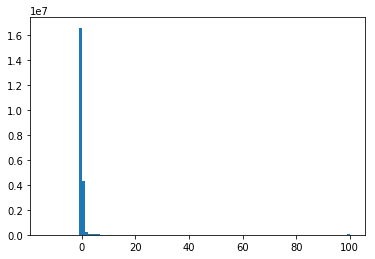

In [20]:
plt.hist(x.ravel(), bins = 100)
plt.show()

In [21]:
idx = np.where(x.ravel() ==100)
x = x.ravel()
x[idx] = 0

In [22]:
x = x.reshape(-1,3,101,101)

max  99.9993228912
min  -13.5008227825
mean  0.234163777951
std:  2.28775757018


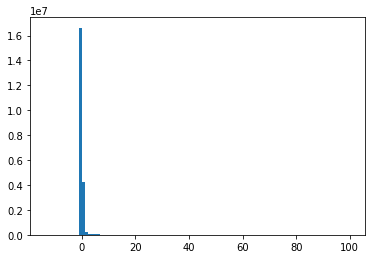

In [23]:
plt.hist(x.ravel(),bins = 100)
print 'max ', np.max(x)
print 'min ', np.min(x)
print 'mean ', np.mean(x)
print 'std: ', np.std(x)
plt.show()

In [24]:
print x.shape

(702, 3, 101, 101)


In [25]:
import datetime
from sklearn.model_selection import train_test_split
from deeplens.resnet_classifier import deeplens_classifier

Using Theano backend.


# Training:

13
x_lens_train shape: (114, 3, 101, 101)
y_lens_train shape: (114, 1)
x_lens_val shape: (38, 3, 101, 101)
y_lens_val shape: (38, 1)
x_nonlens_train shape: (385, 3, 101, 101)
y_nonlens_train shape: (385, 1)
x_nonlens_val shape: (165, 3, 101, 101)
y_nonlens_val shape: (165, 1)
(499, 3, 101, 101)
(499, 1)
(203, 3, 101, 101)
(203, 1)
press enter to save sets
press enter to begin training
2018-08-13 02:59:15.822869
Training begining...
140 epochs...
499 images...
Starting Epoch : 0
0.0
Epoch took 454.565699 s
Starting Epoch : 1
0.0
Epoch took 437.342336 s
Starting Epoch : 2
0.493939399719
Epoch took 428.152320 s
Starting Epoch : 3
0.786443352699
Epoch took 424.673576 s
Starting Epoch : 4
0.679904460907
Epoch took 430.928042 s
Starting Epoch : 5
Iteration : 15 -> [Validation] Purity: nan ; Completeness: 0.000000
Iteration : 15 -> [Training] Purity: nan ; Completeness: 0.000000
0.580303013325
Epoch took 430.794151 s
Starting Epoch : 6
0.636842250824
Epoch took 435.124023 s
Starting Epoch : 7

Iteration : 255 -> [Training] Purity: 0.882883 ; Completeness: 0.859649
0.961882174015
Epoch took 442.326129 s
Starting Epoch : 86
0.960765600204
Epoch took 444.414141 s
Starting Epoch : 87
0.960765480995
Epoch took 442.498939 s
Starting Epoch : 88
0.961084544659
Epoch took 443.889797 s
Starting Epoch : 89
0.963795959949
Epoch took 441.797734 s
Starting Epoch : 90
Iteration : 270 -> [Validation] Purity: 0.868421 ; Completeness: 0.868421
Iteration : 270 -> [Training] Purity: 0.980198 ; Completeness: 0.868421
saving to deeplens_params_90.npy...
0.964593291283
Epoch took 439.059546 s
Starting Epoch : 91
0.963636398315
Epoch took 443.130186 s
Starting Epoch : 92
0.963955461979
Epoch took 437.363273 s
Decreasing learning rate to:1e-05
Starting Epoch : 93
0.963477134705
Epoch took 441.213267 s
Starting Epoch : 94
0.963636577129
Epoch took 451.621013 s
Starting Epoch : 95
Iteration : 285 -> [Validation] Purity: 0.861111 ; Completeness: 0.815789
Iteration : 285 -> [Training] Purity: 0.960000 ;

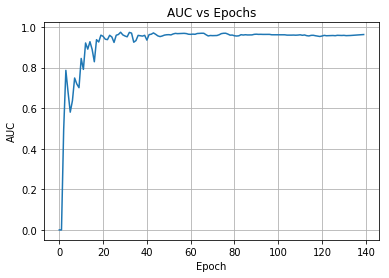

Epoch took 544.420896 s
saving to /Users/Chris/Desktop/DECals_set/Trained_Models/model_13/saves/deeplens_params_final.npy...
2018-08-13 22:27:35.367492

Completed Training Model 13!


In [26]:
import datetime
from sklearn.model_selection import train_test_split
from deeplens.resnet_classifier import deeplens_classifier




for i in range (13,14):
    print i
    #shuffle lenses and split 
    x_lens_train, x_lens_val, y_lens_train, y_lens_val = train_test_split(x[:lens,:,:,:], y[:lens], test_size=0.25, shuffle = True)
    x_nonlens_train, x_nonlens_val, y_nonlens_train, y_nonlens_val = train_test_split(x[lens:702,:,:,:], y[lens:702], test_size=0.3, shuffle = True)
    
    print 'x_lens_train shape:',x_lens_train.shape
    print 'y_lens_train shape:', y_lens_train.shape
    print 'x_lens_val shape:',x_lens_val.shape
    print 'y_lens_val shape:',y_lens_val.shape
    print 'x_nonlens_train shape:',x_nonlens_train.shape
    print 'y_nonlens_train shape:',y_nonlens_train.shape
    print 'x_nonlens_val shape:',x_nonlens_val.shape
    print 'y_nonlens_val shape:',y_nonlens_val.shape

    #take array of lenses and the non lenses
    x_train = np.concatenate((x_lens_train,x_nonlens_train))
#     x_train = np.concatenate((x_lens_train,x_nonlens_train,x_cluster_nonlens_train))
    #make target array corresponding to x_train
    y_train = np.concatenate((y_lens_train, y_nonlens_train))
#     y_train = np.concatenate((y_lens_train, y_nonlens_train, y_cluster_nonlens_train))
    xval = np.concatenate((x_lens_val,x_nonlens_val))
#     xval = np.concatenate((x_lens_val,x_nonlens_val, x_cluster_nonlens_val))
    
    yval = np.concatenate((y_lens_val, y_nonlens_val))
#     yval = np.concatenate((y_lens_val, y_nonlens_val, y_cluster_nonlens_val))
    
    print x_train.shape
    print y_train.shape
    print xval.shape
    print yval.shape
    
    
    user_save = raw_input('press enter to save sets')

    np.save('/Users/Chris/Desktop/DECals_set/Trained_Models/model_{}/x_y_sets/x_train.npy'.format(i),x_train)
    np.save('/Users/Chris/Desktop/DECals_set/Trained_Models/model_{}/x_y_sets/y_train.npy'.format(i),y_train)
    np.save('/Users/Chris/Desktop/DECals_set/Trained_Models/model_{}/x_y_sets/xval.npy'.format(i),xval)
    np.save('/Users/Chris/Desktop/DECals_set/Trained_Models/model_{}/x_y_sets/yval.npy'.format(i),yval)

    

    user_begin = raw_input('press enter to begin training')

    model = deeplens_classifier(learning_rate=0.001, learning_rate_steps=3, learning_rate_drop=0.1, batch_size=128, n_epochs=int(user_epochs))           
    print(datetime.datetime.now())
    print 'Training begining...'
    print user_epochs+' epochs...'
    print str(x_train.shape[0]) + ' images...'

    model.fit(x_train,y_train,xval,yval) 

    np.save('/Users/Chris/Desktop/DECals_set/Trained_Models/model_{}/auc/auc.npy'.format(i),np.array(list(model.roc_auc.items()), dtype=float))

    model.save('/Users/Chris/Desktop/DECals_set/Trained_Models/model_{}/saves/deeplens_params_final.npy'.format(i))
    
    for j in range((int(user_epochs)/10) - 1):
        shutil.move('/Users/Chris/CMUDeepLens/notebooks/deeplens_params_{}.npy'.format((j+1)*10), '/Users/Chris/Desktop/DECals_set/Trained_Models/model_{}/saves/deeplens_params_{}.npy'.format(i,j*10))
    
    shutil.move('/Users/Chris/CMUDeepLens/notebooks/AUC_vs_Epoch.png', '/Users/Chris/Desktop/DECals_set/Trained_Models/model_{}/auc/AUC_vs_Epoch.png'.format(i))

    print(datetime.datetime.now())

    print '\nCompleted Training Model {}!'.format(i)

In [31]:
shutil.move('/Users/Chris/CMUDeepLens/notebooks/AUC_vs_Epoch.png', '/Users/Chris/Desktop/DECals_set/Trained_Models/model_{}/auc/AUC_vs_Epoch.png'.format(i))
    
    

In [37]:
for i in range(xval.shape[0]):
    for j in range(x_train.shape[0]):
        if np.all(xval[i] == x_train[j]):
            print i,j

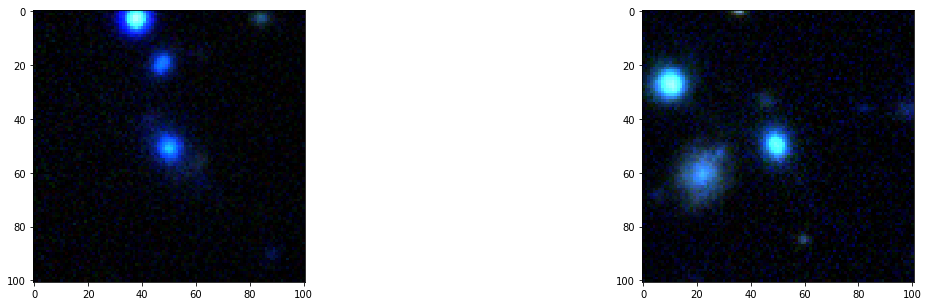

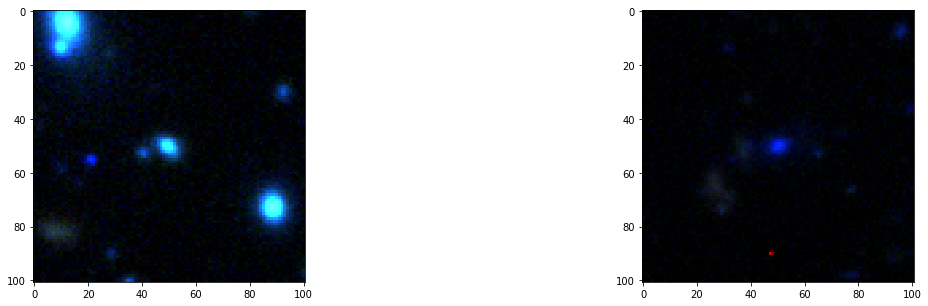

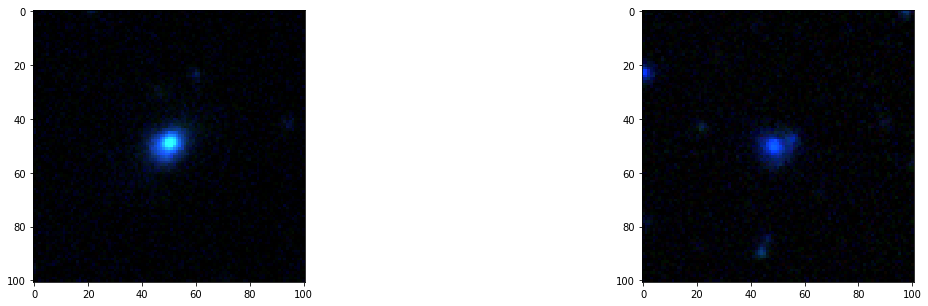

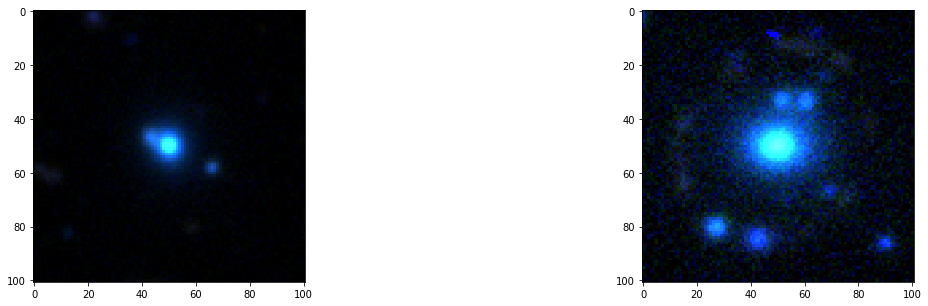

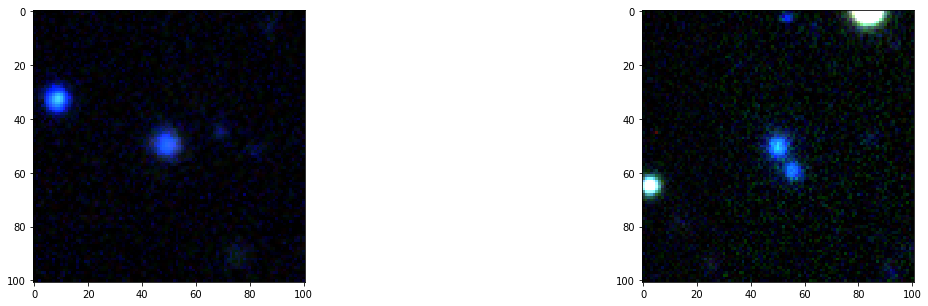

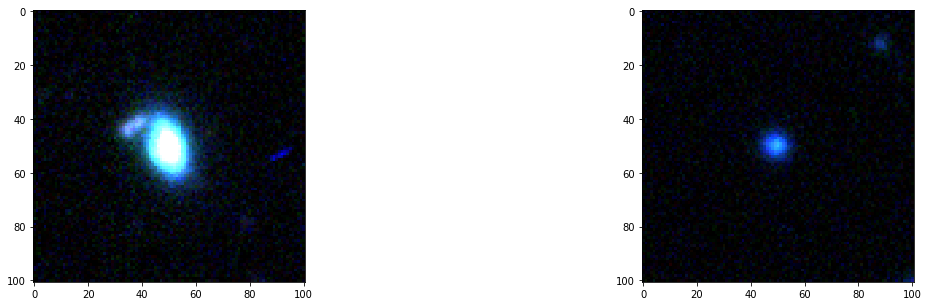

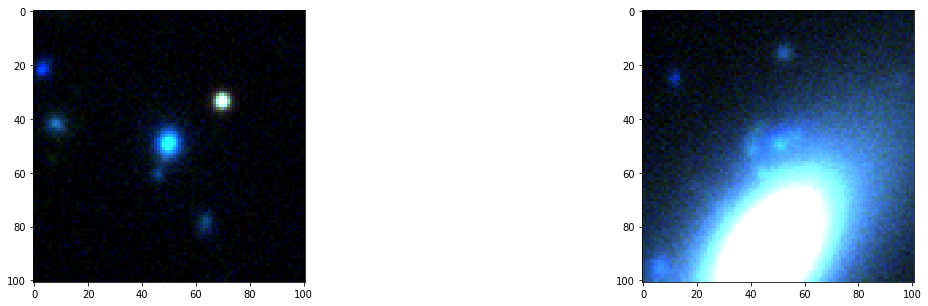

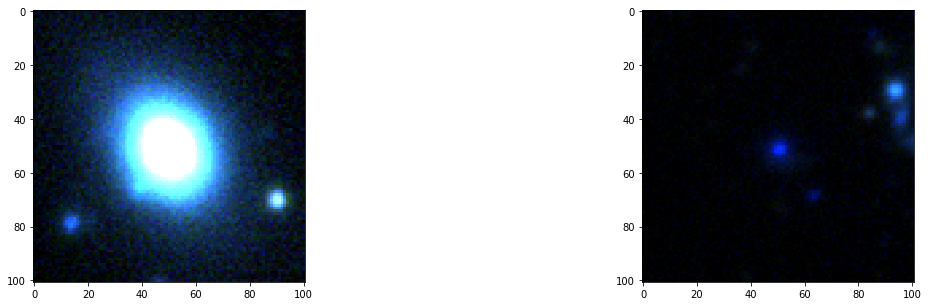

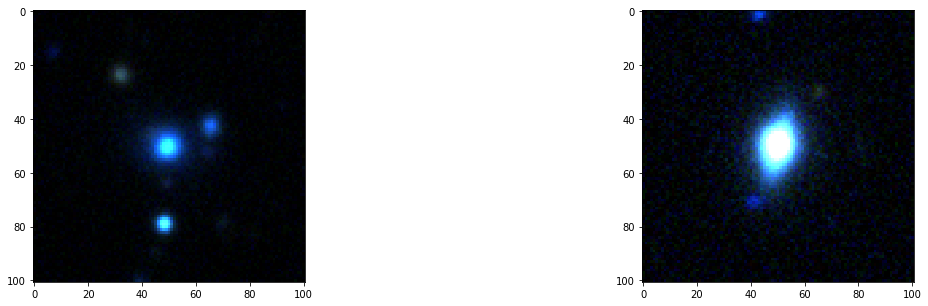

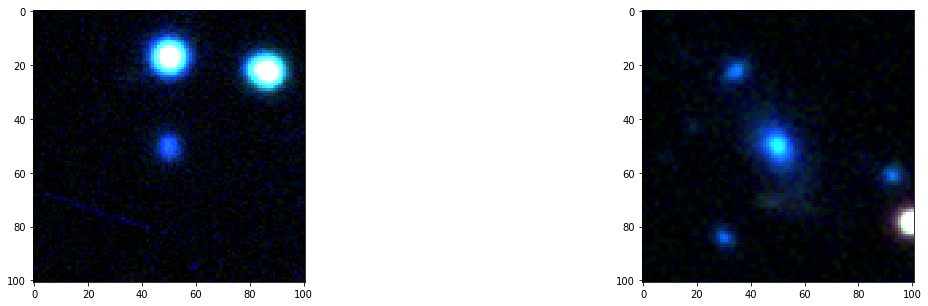

In [44]:
for i in range(10):
    plt.figure(figsize = (20,5))
    plt.subplot(121)
    plt.imshow(x_train[i].T/8)
    plt.subplot(122)
    plt.imshow(xval[i].T/8)

# If model already trained:

In [6]:
from deeplens.resnet_classifier import deeplens_classifier

model_num = 5

train_step = 'final'

x_train = np.load('/Users/Chris/Desktop/DECals_set/Trained_Models/model_{}/x_y_sets/x_train.npy'.format(model_num))

y_train = np.load('/Users/Chris/Desktop/DECals_set/Trained_Models/model_{}/x_y_sets/y_train.npy'.format(model_num))

xval = np.load('/Users/Chris/Desktop/DECals_set/Trained_Models/model_{}/x_y_sets/xval.npy'.format(model_num))

yval = np.load('/Users/Chris/Desktop/DECals_set/Trained_Models/model_{}/x_y_sets/yval.npy'.format(model_num))

model = deeplens_classifier()

model.load('/Users/Chris/Desktop/DECals_set/Trained_Models/model_{}/saves/deeplens_params_{}.npy'.format(model_num,train_step), x_train, y_train)

loading from /Users/Chris/Desktop/DECals_set/Trained_Models/model_5/saves/deeplens_params_final.npy...
Model loaded


# Testing:

In [95]:
prediction = model.predict(xval)
proba = model.predict_proba(xval)

In [96]:
from scipy.ndimage import rotate

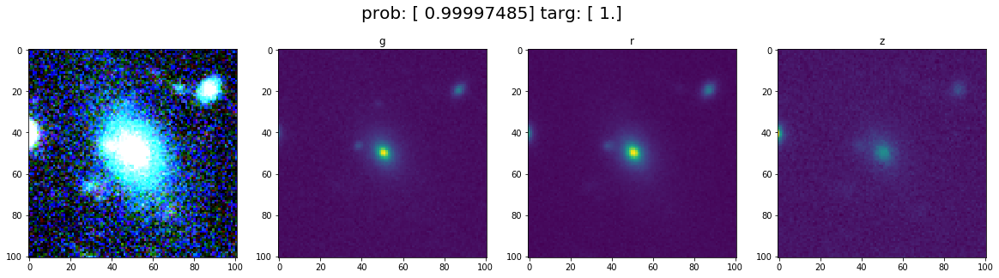

INDEX:  0


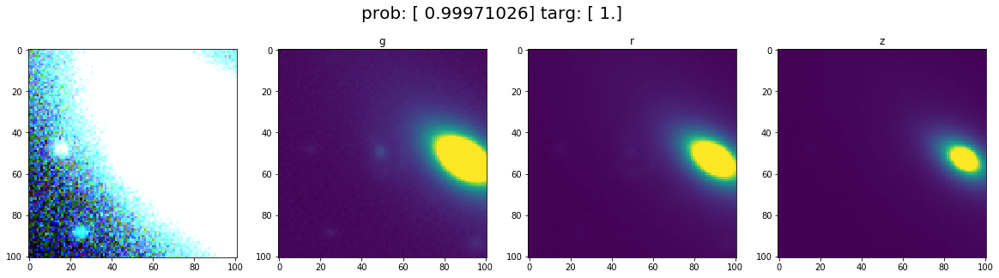

INDEX:  2


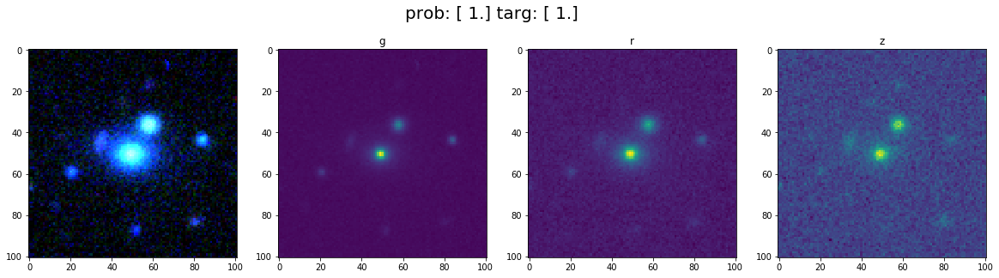

INDEX:  3


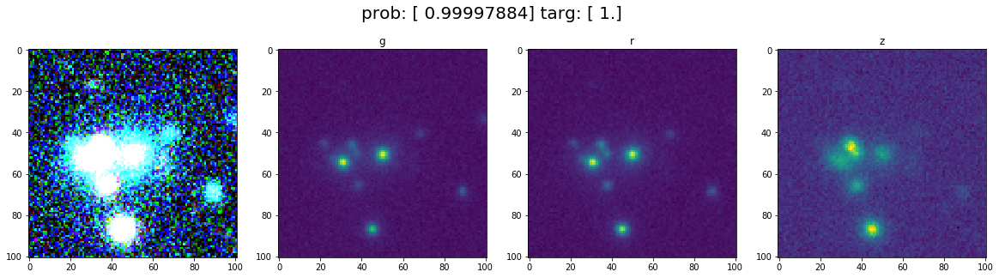

INDEX:  4


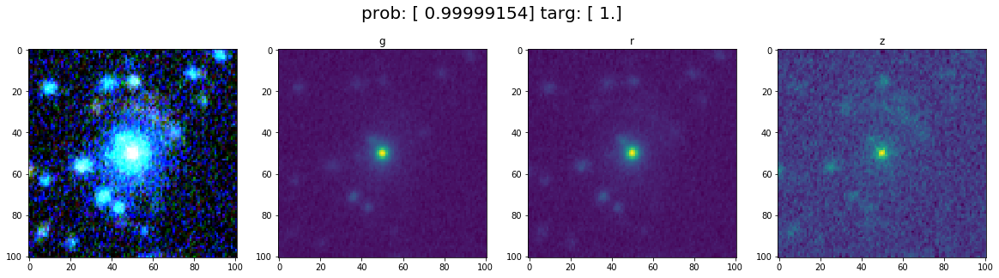

INDEX:  5


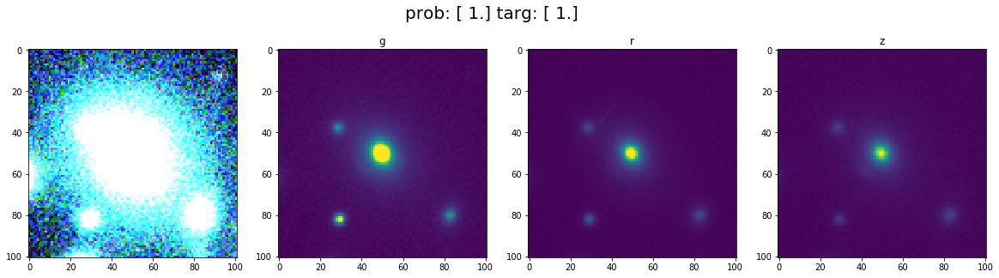

INDEX:  6


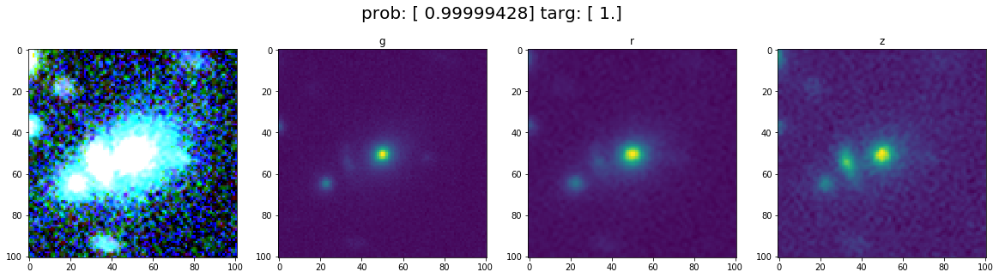

INDEX:  7


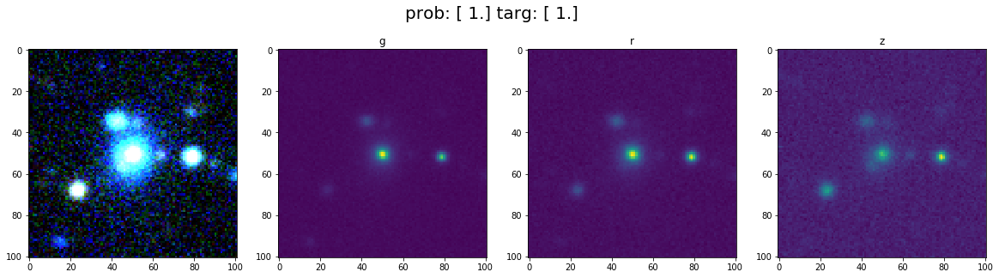

INDEX:  9


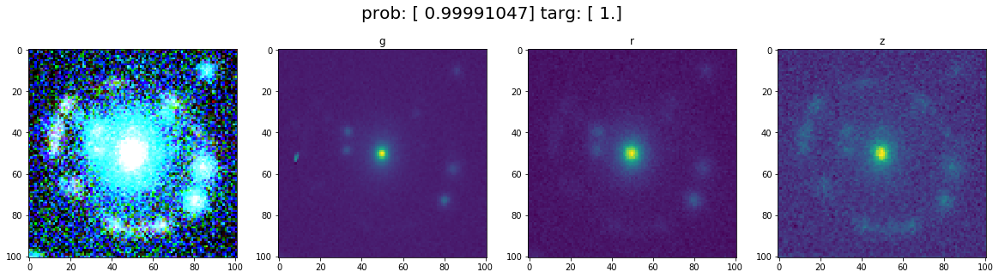

INDEX:  10


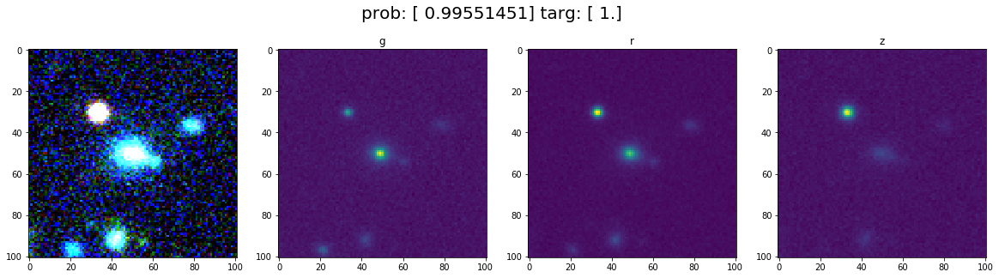

INDEX:  11


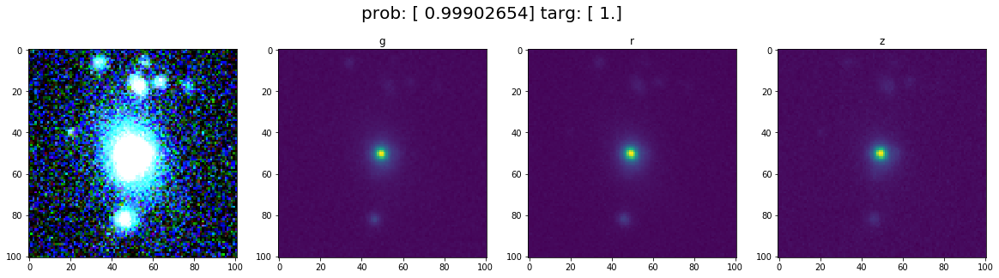

INDEX:  12


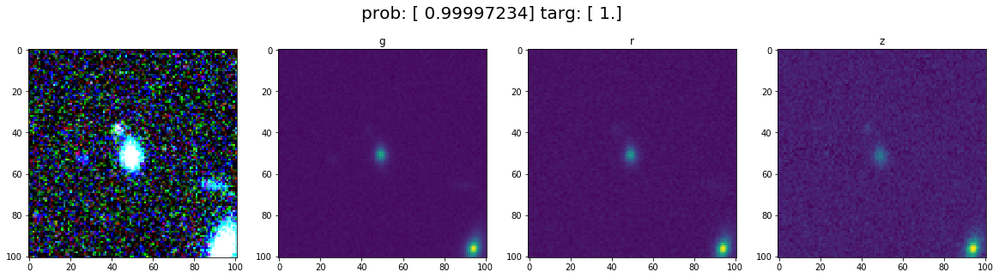

INDEX:  13


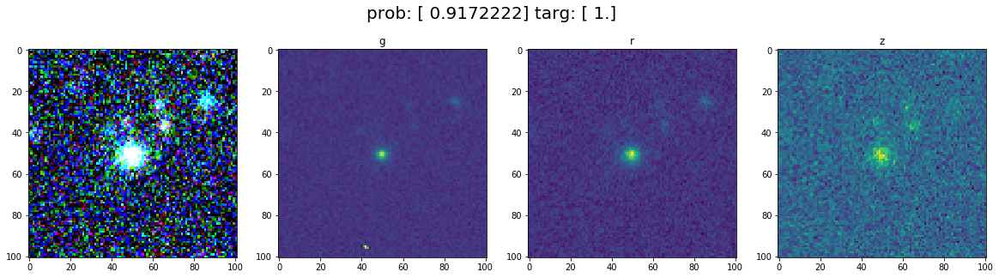

INDEX:  14


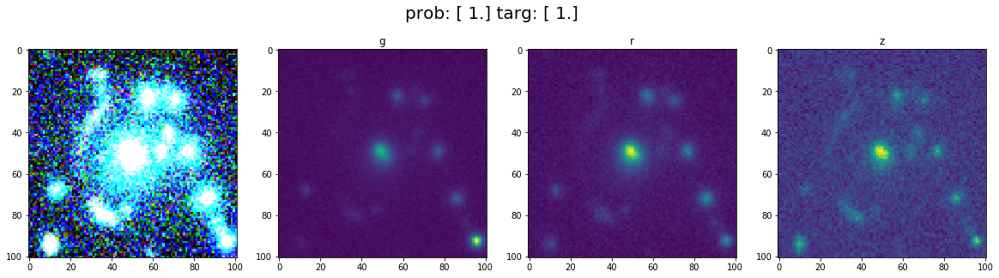

INDEX:  15


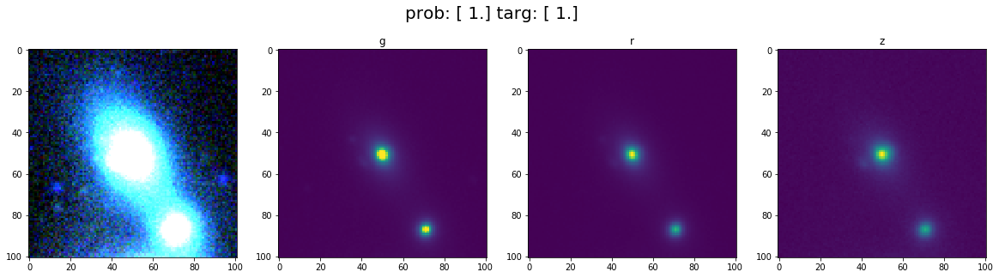

INDEX:  16


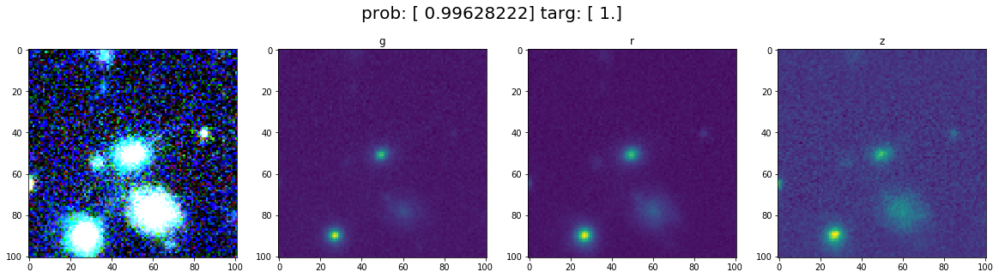

INDEX:  17


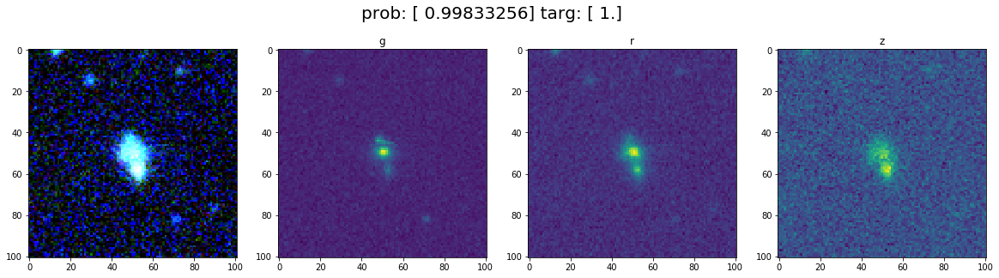

INDEX:  18


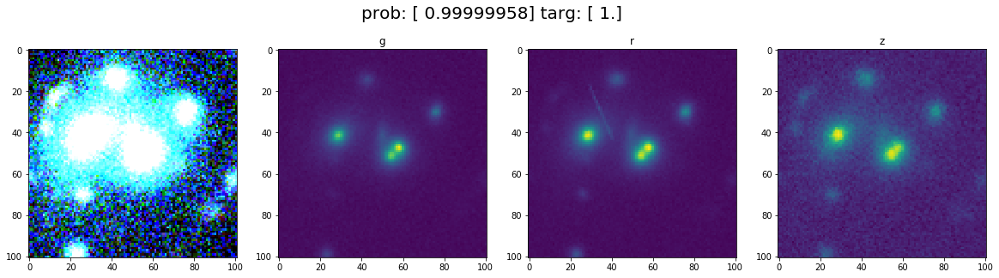

INDEX:  19


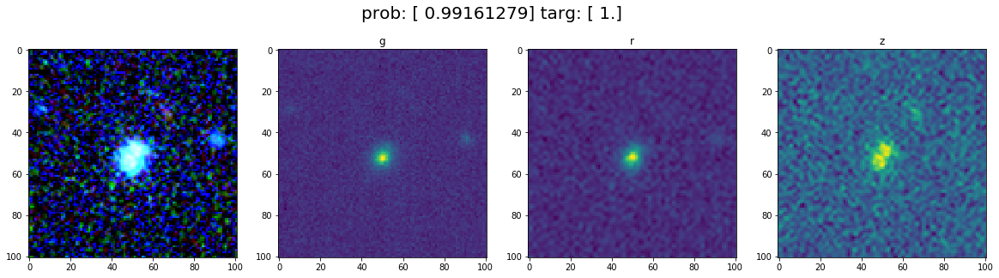

INDEX:  20


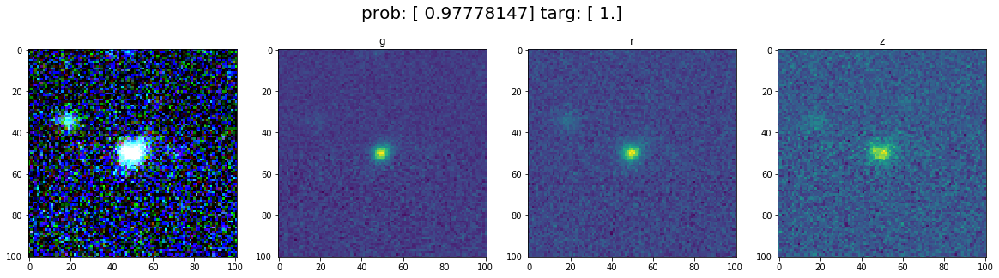

INDEX:  21


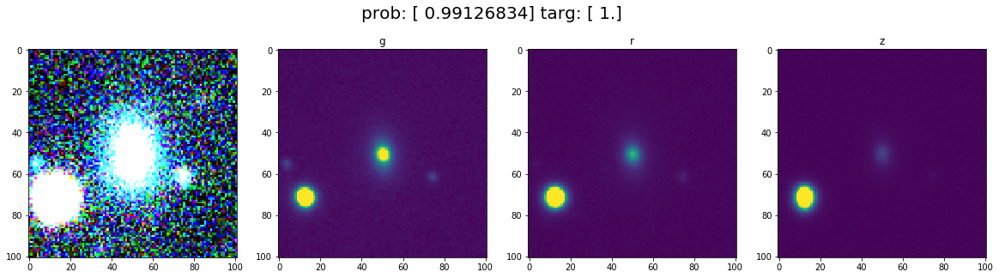

INDEX:  22


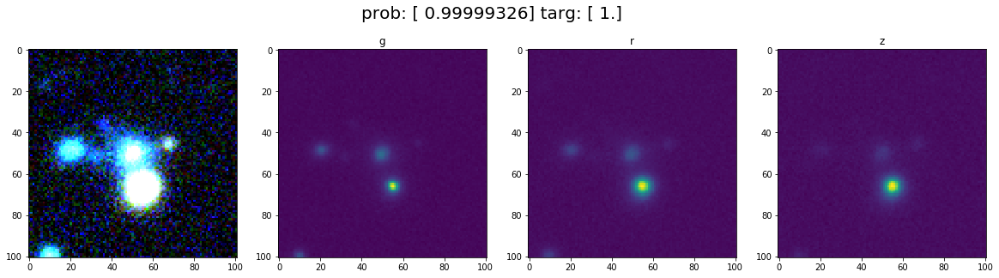

INDEX:  23


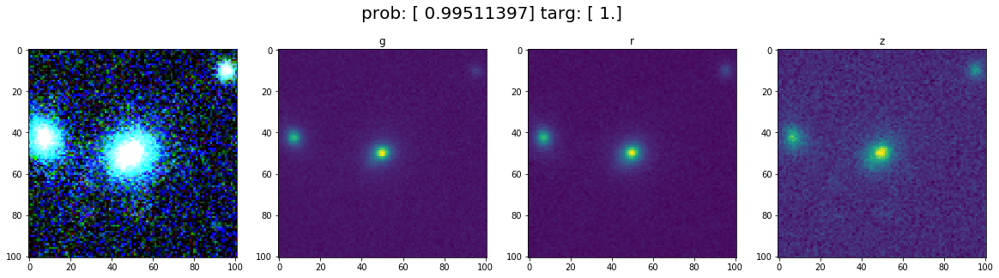

INDEX:  24


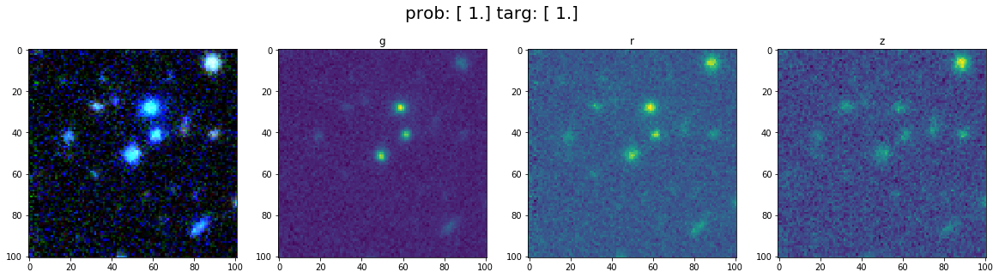

INDEX:  25


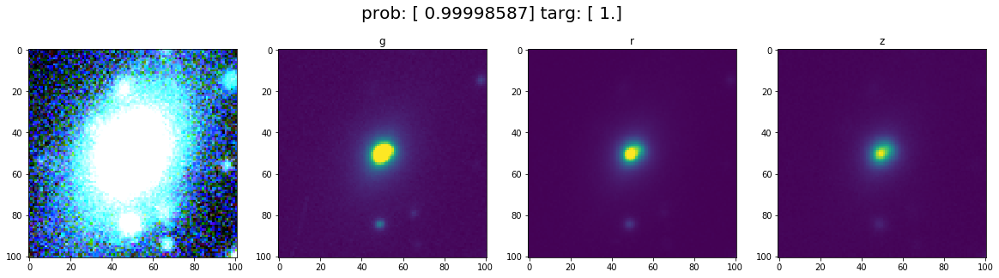

INDEX:  27


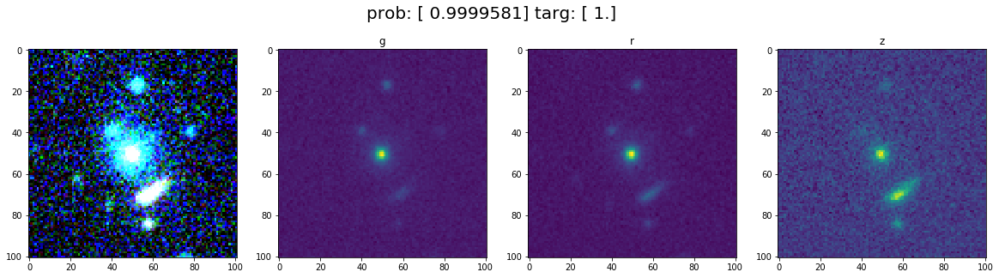

INDEX:  28


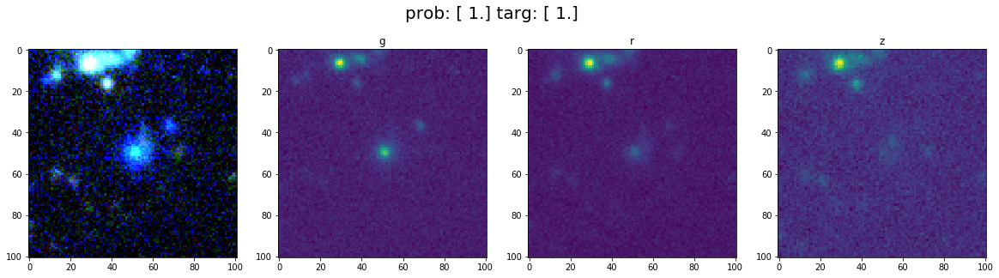

INDEX:  29


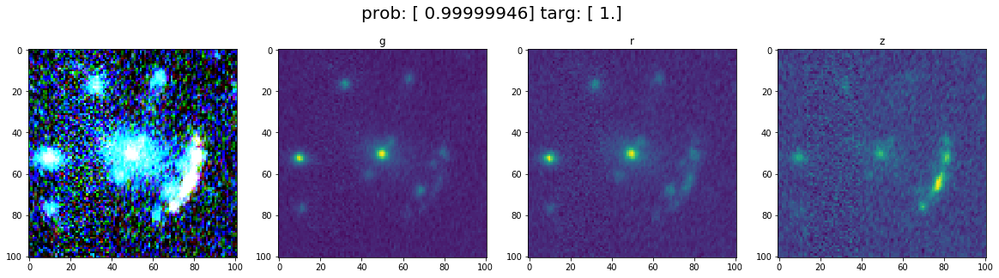

INDEX:  30


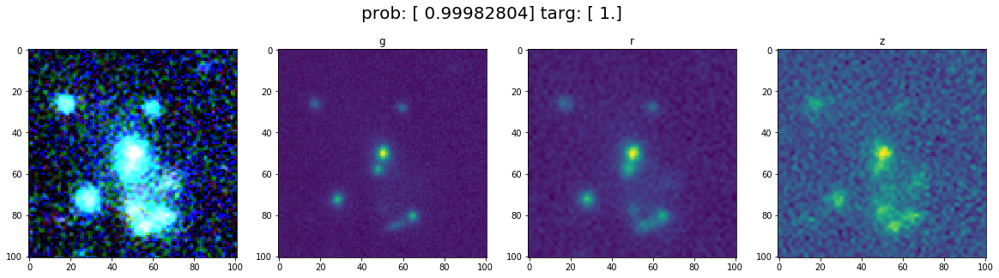

INDEX:  31


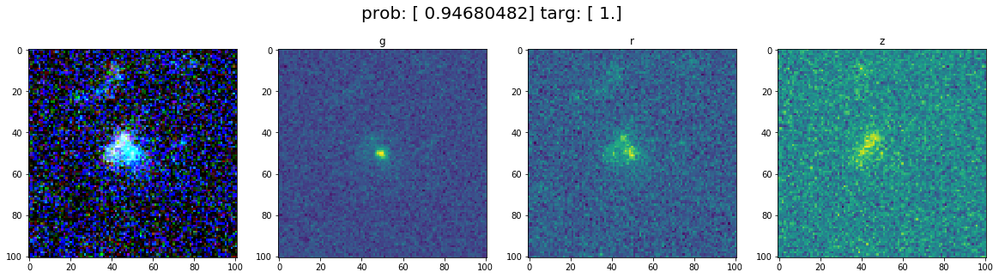

INDEX:  32


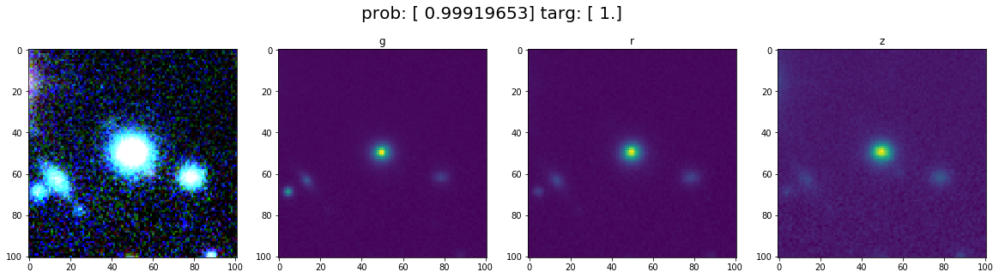

INDEX:  33


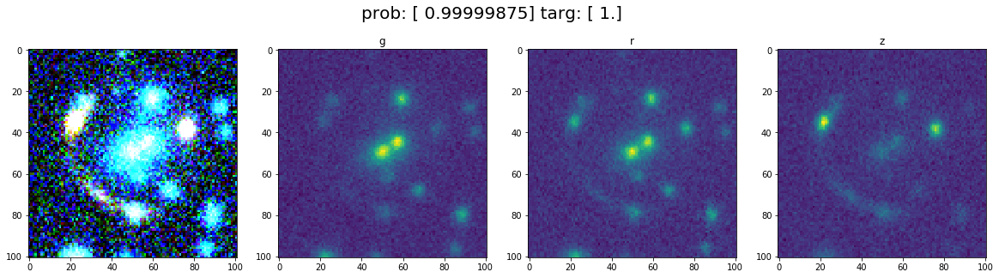

INDEX:  34
32


In [98]:
counter = 0
for image, targ, probability in zip(xval, yval, proba):
    if targ == 1 and probability>0.8:
#         print counter
        counter +=1
        if counter == 0:
            nonlens = image
        image = rotate(image.T, 90.)
        plt.figure(figsize=(20,5))
        plt.suptitle('prob: '+ str(probability)+ ' targ: ' +str(targ), fontsize = 20)
        plt.subplot(141) 
        plt.imshow(image)
        plt.subplot(142)
        plt.title('g')
        plt.imshow(image[:,:,2])
        plt.subplot(143)
        plt.title('r')
        plt.imshow(image[:,:,1])
        plt.subplot(144)
        plt.title('z')
        plt.imshow(image[:,:,0])
        plt.show()
        for j, images in enumerate(xval):
            if np.all(rotate(images.T, 90.) == image):
                print "INDEX: ", j
print counter


In [61]:
test = fits.getdata('/Users/Chris/Desktop/test_image.fits')
test.ravel()
test*=3
clip = 5

test = np.clip(test, -clip, clip)*20

test = test.reshape(1,3,101,101)

In [89]:
test_imgs = np.concatenate((xval[8].reshape(1,3,101,101),test))

In [90]:
proba_test = model.predict_proba(test_imgs)

In [91]:
proba_test


array([[ 0.08636661],
       [ 0.99999803]], dtype=float32)

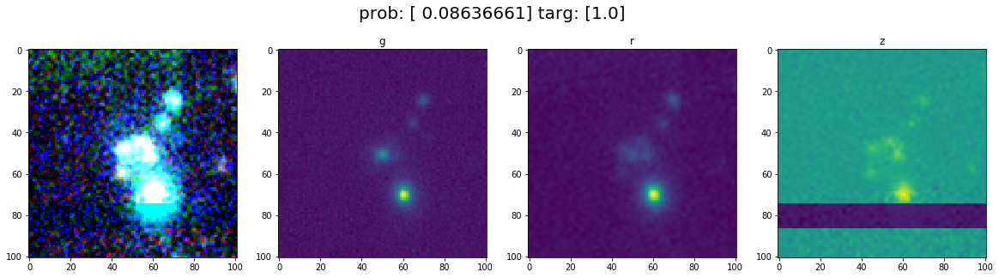

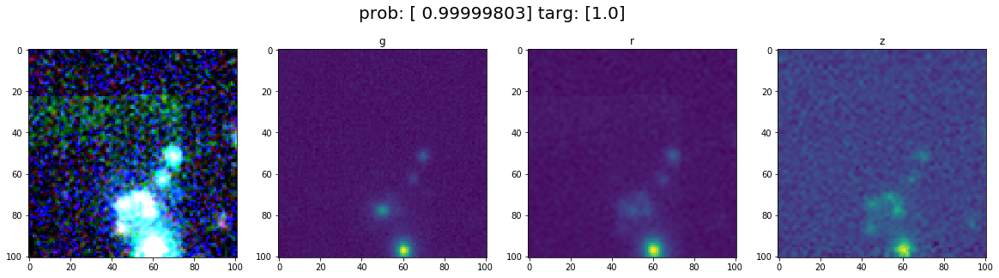

In [92]:
for image, proba_test in zip(test_imgs, proba_test):
    image = rotate(image.T, 90.)
    plt.figure(figsize=(20,5))
    plt.suptitle('prob: '+ str(proba_test)+ ' targ: ' +str([1.0]), fontsize = 20)
    plt.subplot(141) 
    plt.imshow(image)
    plt.subplot(142)
    plt.title('g')
    plt.imshow(image[:,:,2])
    plt.subplot(143)
    plt.title('r')
    plt.imshow(image[:,:,1])
    plt.subplot(144)
    plt.title('z')
    plt.imshow(image[:,:,0])
    plt.show()

260
261


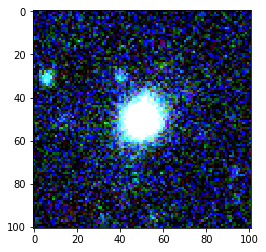

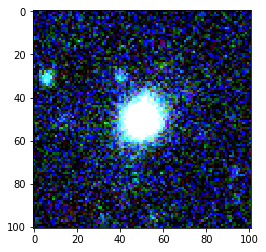

1001.0


In [216]:
image = np.copy(xval[27])
plt.imshow(rotate(image.T,90))

for i, images in enumerate(x):
    if np.all(images == image):
        print i
plt.imshow(rotate(x[260].T,90))
plt.show()
plt.imshow(rotate(x[261].T,90))
plt.show()
print selected_ims[260-81]

0.681818181818


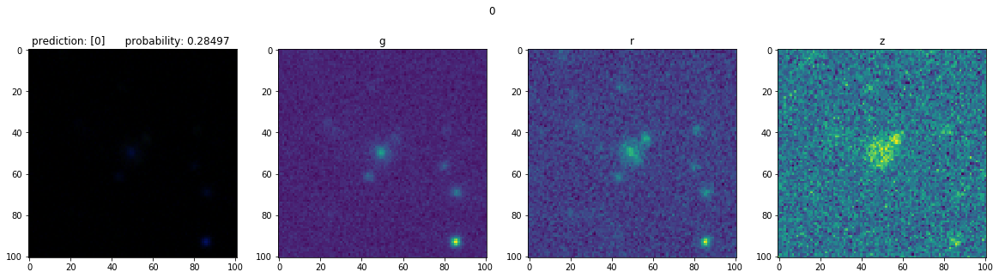

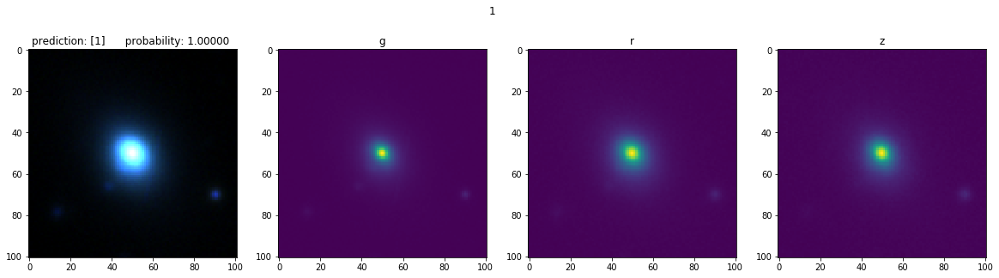

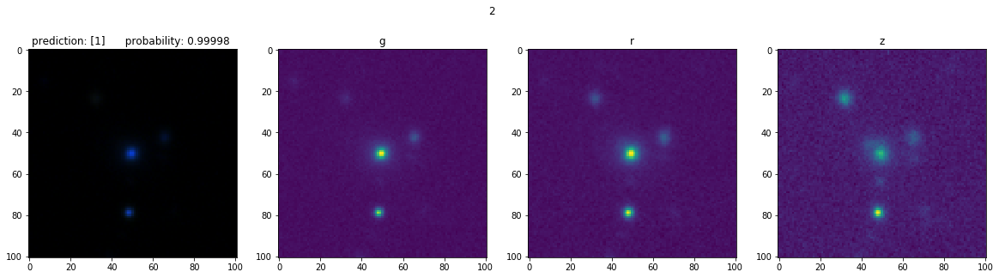

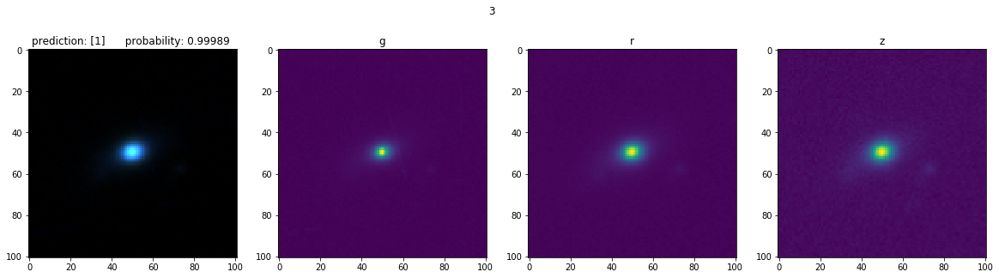

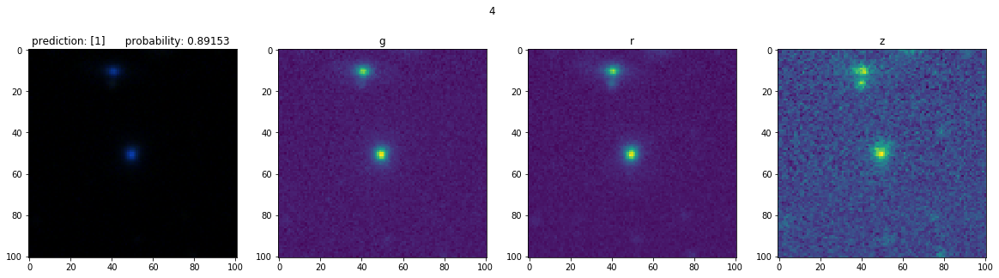

...

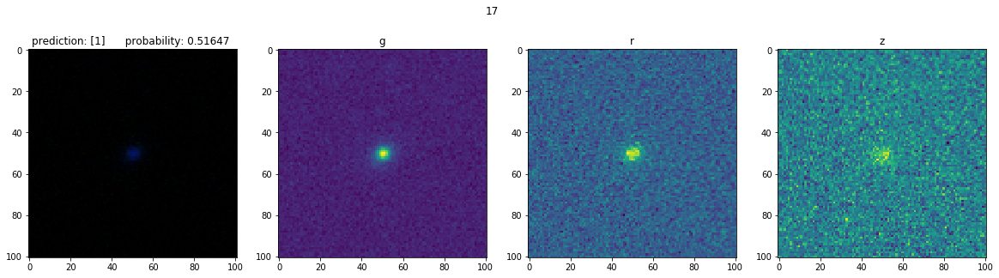

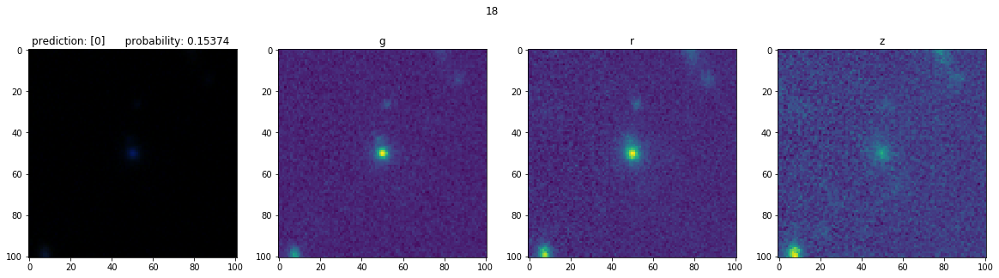

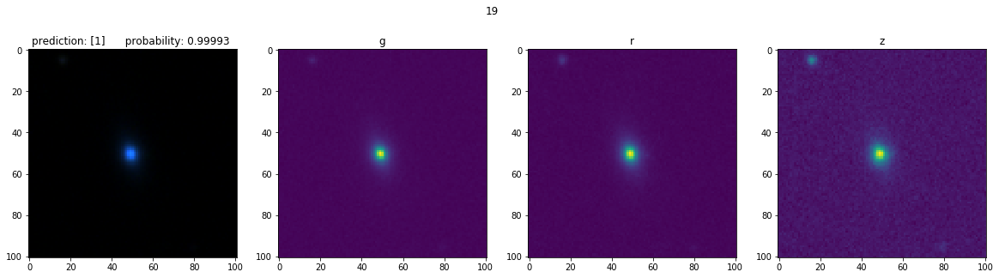

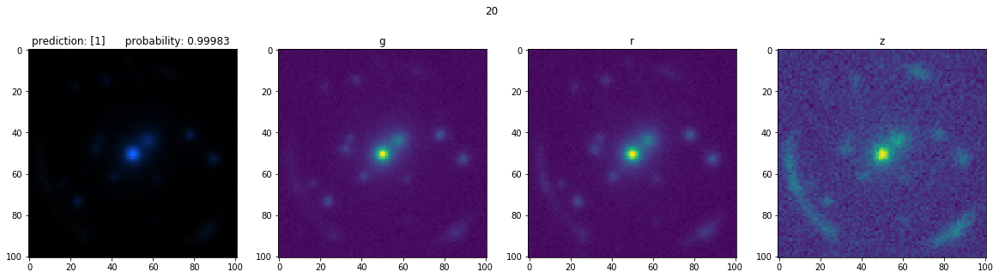

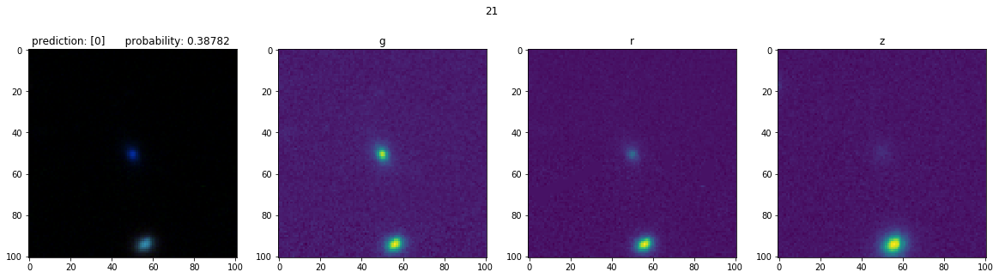

In [61]:
#show lenses and scores
for a in range(22):
    plt.figure(figsize=(20,5))
    plt.suptitle(a)
    plt.subplot(141)
    plt.title('prediction: '+ str(prediction[a])+'      probability: {0:.5f} '.format(float(proba[a]))) 
    plt.imshow(x_lens_test[a].T)
    plt.subplot(142)
    plt.title('g')
    plt.imshow(x_lens_test[a,2,:,:].T)
    plt.subplot(143)
    plt.title('r')
    plt.imshow(x_lens_test[a,1,:,:].T)
    plt.subplot(144)
    plt.title('z')
    plt.imshow(x_lens_test[a,0,:,:].T)
    plt.show()


In [77]:
model.predict_proba(x_lens_test[9].reshape(1,3,101,101)*2)

array([[ 0.97778237]], dtype=float32)

In [79]:
x_nonlens_test = np.zeros((78,3,101,101))

In [80]:
for k in range(x_nonlens_test.shape[0]):
    x_nonlens_test[k] = fits.getdata('/Users/Chris/Desktop/DECals_set/Non-Lenses/images/cutout_{:06d}.fits'.format(k+int(np.max(selected_ims))))


In [83]:
prediction_nonlens = model.predict(x_nonlens_test)
proba_nonlens = model.predict_proba(x_nonlens_test)

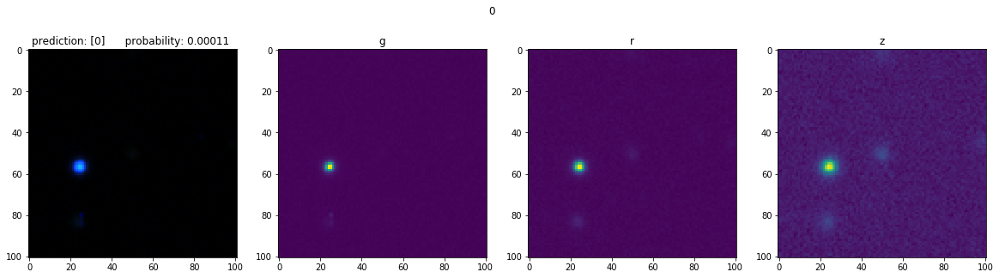

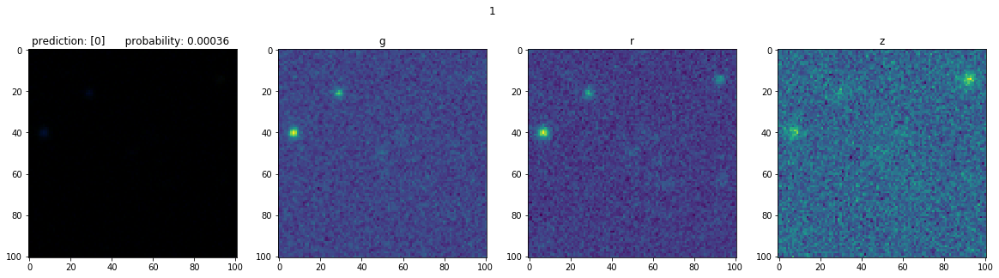

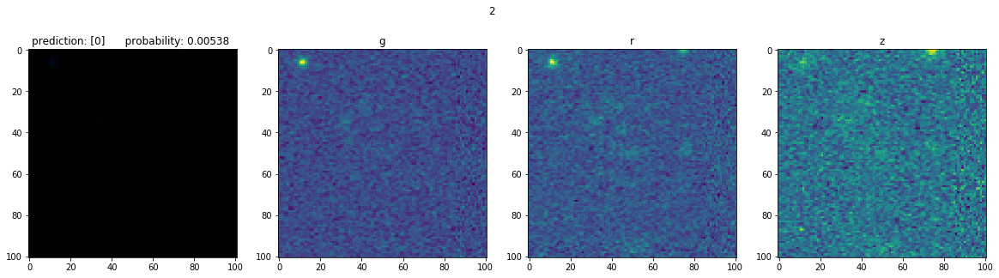

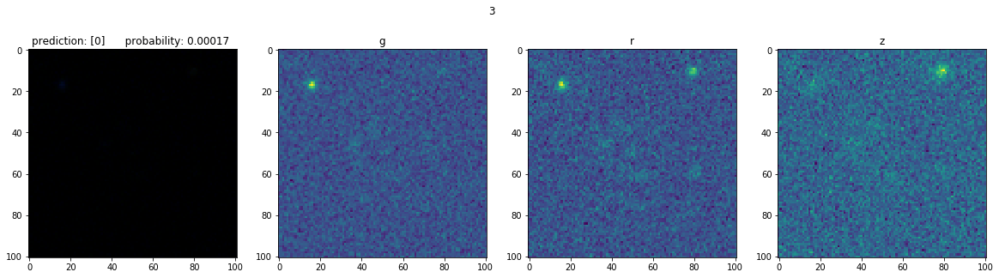

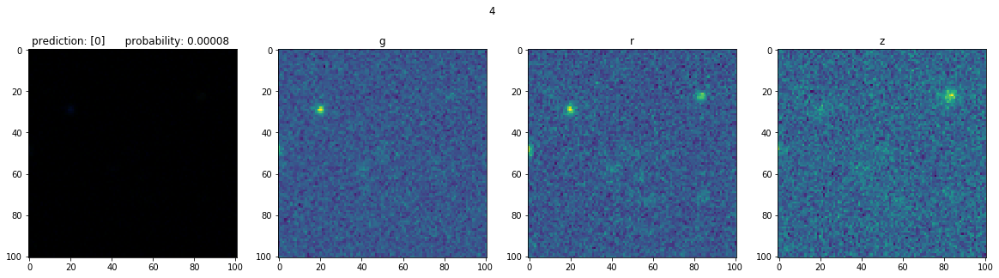

...

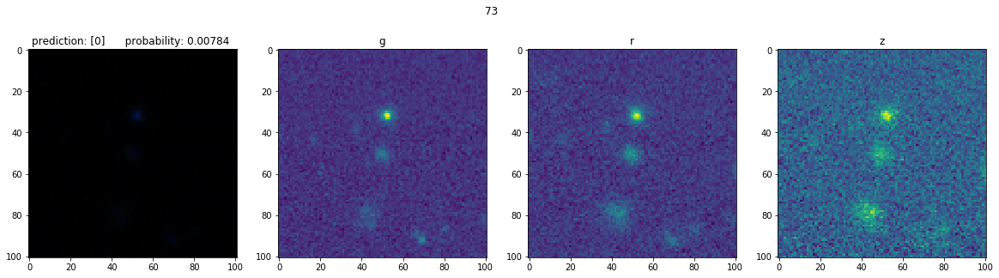

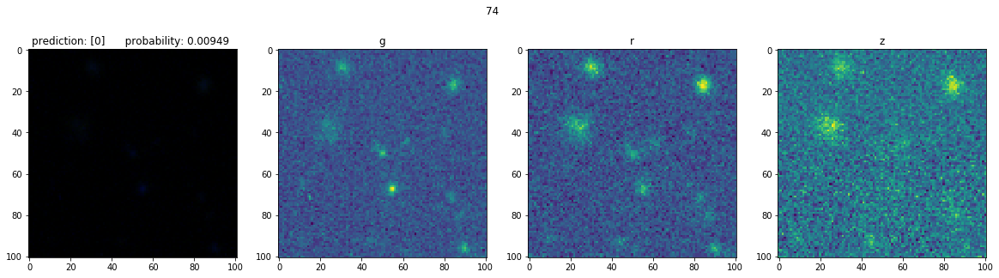

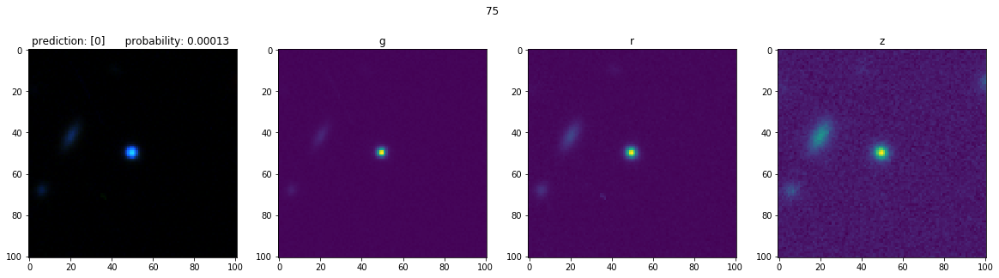

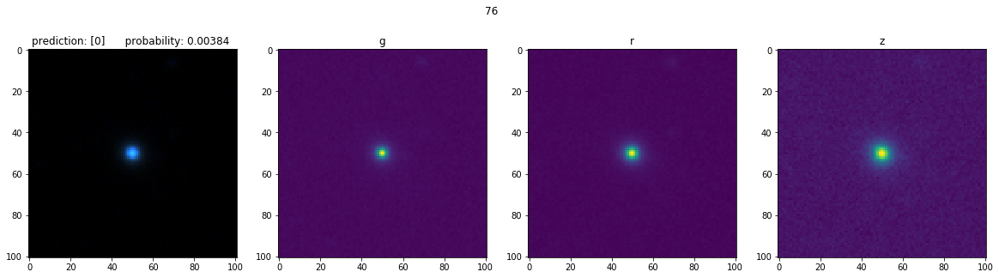

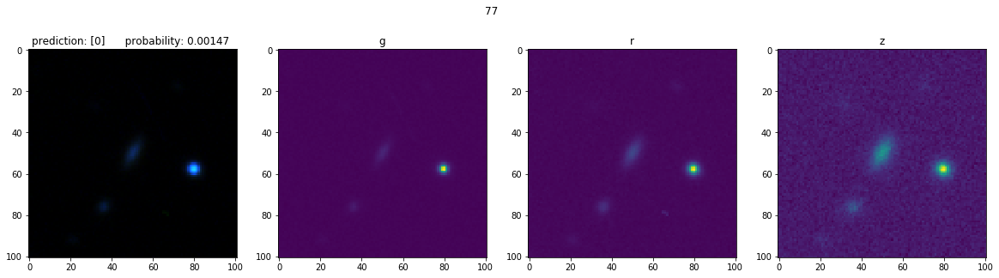

In [84]:
#show lenses and scores
for b in range(78):
    plt.figure(figsize=(20,5))
    plt.suptitle(b)
    plt.subplot(141)
    plt.title('prediction: '+ str(prediction_nonlens[b])+'      probability: {0:.5f} '.format(float(proba_nonlens[b]))) 
    plt.imshow(x_nonlens_test[b].T)
    plt.subplot(142)
    plt.title('g')
    plt.imshow(x_nonlens_test[b,2,:,:].T)
    plt.subplot(143)
    plt.title('r')
    plt.imshow(x_nonlens_test[b,1,:,:].T)
    plt.subplot(144)
    plt.title('z')
    plt.imshow(x_nonlens_test[b,0,:,:].T)
    plt.show()


In [104]:
prediction_nonlens = model.predict(x_nonlens_test)
print np.sum(prediction_nonlens)/float(x_nonlens_test.shape[0])

0.0


In [85]:
x_test = np.concatenate((x_lens_test,x_nonlens_test))

In [86]:
y_nonlens_test = np.zeros((x_nonlens_test.shape[0],1))

In [87]:
y_test = np.concatenate((y_lens_test,y_nonlens_test ))

In [88]:
x_test, none, y_test, none = train_test_split(x_test, y_test, test_size=0.0, shuffle = True)

In [89]:
print x_test.shape
print y_test.shape
print np.sum(y_test)

(100, 3, 101, 101)
(100, 1)
22.0


In [7]:
tpr,fpr,th = model.eval_ROC(xval,yval)


In [8]:
tpr.shape

(10000000,)

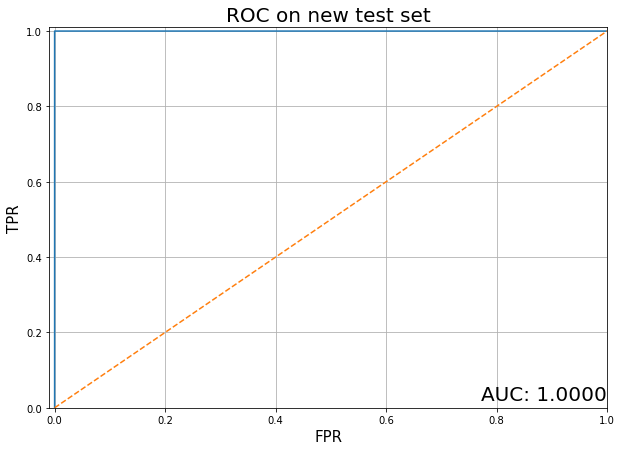

In [9]:
from sklearn import metrics
roc_auc = metrics.auc(fpr, tpr)
plt.figure(figsize= (10,7))
plt.title('ROC on new test set', fontsize=20)
plt.plot(fpr,tpr)
# plt.xlim([0,0.1])
# plt.ylim([0.6,0.8])
plt.xlabel('FPR', fontsize=15)
plt.ylabel('TPR', fontsize=15)
plt.plot([0, 1], [0, 1], linestyle='--')
plt.xlim([-0.01, 1.0])
plt.ylim([0.0, 1.01])
plt.text(1, 0.01, 'AUC: ' + str("%.4f" % roc_auc),
        verticalalignment='bottom', horizontalalignment='right', fontsize=20)
plt.grid(True)

plt.show()

# Testing on GroundBased images:


In [54]:
imgs = 100
cat = Table.read('//Volumes/CJSTORFER/GroundBasedTraining/classifications.csv')
cat= cat[0:imgs]

In [81]:
ims = np.zeros((imgs, 3, 101, 101))
counter = 0


for i, id in enumerate(cat['ID']):
    if (i%10 == 0) and (i!=0):
        counter +=1
        print str(counter)+"0 done."
    for j, b in enumerate(['R', 'I', 'G']):
        ims[i, j] = fits.getdata('//Volumes/CJSTORFER/GroundBasedTraining/Public/Band'+str(j+1)+'/imageSDSS_'+b+'-'+str(id)+'.fits')
        cat['image'] = ims

cat.write('/Users/Chris/Desktop/catalogs_'+str(imgs)+'_RGB.hdf5', path='/ground', append=True)
print "Done !"

10 done.
20 done.
30 done.
40 done.
50 done.
60 done.
70 done.
80 done.
90 done.
Done !


In [82]:
from astropy.table import Table

d = Table.read(export_path+'catalogs_'+str(imgs)+'_RGB.hdf5', path='/ground')  # Path to be adjusted on your machine
print d['image'].shape

x_CMU = np.asarray(d['image']).reshape((-1,3,101,101))
print x.shape

y_CMU = np.asarray(d['is_lens']).reshape((-1,1))
print y.shape

(100, 3, 101, 101)
(100, 3, 101, 101)
(100, 1)


In [83]:
vmin=-1e-9
vmax=1e-9
scale=100

mask = np.where(x_CMU == 100)

x_CMU[mask] = 0

x_CMU = np.clip(x_CMU, vmin, vmax)/vmax * 100

In [84]:
tpr_CMU,fpr_CMU,th_CMU = model.eval_ROC(x_CMU,y_CMU)


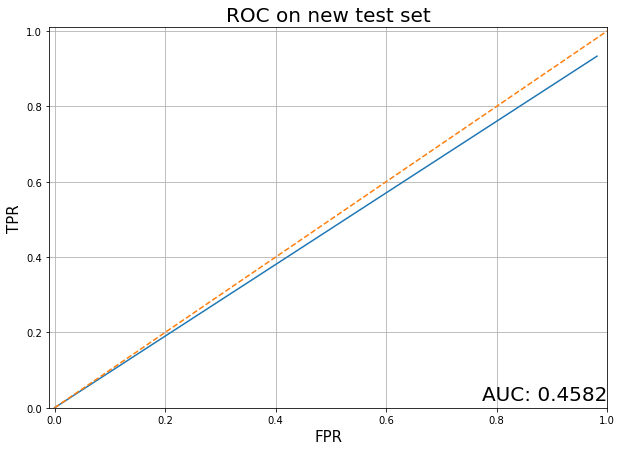

In [85]:
from sklearn import metrics
roc_auc = metrics.auc(fpr_CMU, tpr_CMU)
plt.figure(figsize= (10,7))
plt.title('ROC on new test set', fontsize=20)
plt.plot(fpr_CMU,tpr_CMU)
plt.xlabel('FPR', fontsize=15)
plt.ylabel('TPR', fontsize=15)
plt.xlim(0,1)
plt.ylim(0,1.)
plt.plot([0, 1], [0, 1], linestyle='--')
plt.xlim([-0.01, 1.0])
plt.ylim([0.0, 1.01])
plt.text(1, 0.01, 'AUC: ' + str("%.4f" % roc_auc),
        verticalalignment='bottom', horizontalalignment='right', fontsize=20)
plt.grid(True)

plt.show()

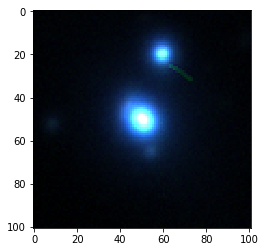

In [88]:
plt.imshow(fits.getdata('/Users/Chris/Desktop/DECals_set/Lenses/gradeA/fits_images/lens_cutout_000023.fits').T)